In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras 
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import image_dataset_from_directory
from keras.layers import Conv2D, Dense, MaxPooling2D, Dropout,Flatten
from keras.models import Model
from keras.applications.vgg16 import VGG16
from tensorflow.keras.applications import MobileNetV3Large
from tensorflow.keras.layers import Flatten, Dense
from tensorflow.keras.models import Model

In [2]:
from tensorflow.keras.models import load_model

vgg_gray_model = load_model('vgg_gray_model1.h5')
vgg_color_model = load_model('vgg_color_model.h5')
vgg_segmented_model = load_model('vgg_segmented_model.h5')

inception_gray_model = load_model('Inception_gray_model.h5')
inception_color_model = load_model('Inception_color_model.h5')
inception_segmented_model = load_model('Inception_segmented_model.h5')

In [3]:
train_gen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    shear_range=0.2,
    zoom_range=0.2,
    width_shift_range=0.05,
    height_shift_range=0.05,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2,
)

valid_gen = ImageDataGenerator(
    rescale=1./255,  # Corrected rescale parameter
    validation_split=0.2,
    
)

Image_size = (255, 255)
Batch_size = 32


In [4]:
Image_size = (255, 255)
Batch_size = 32
seed = 106

In [5]:
import numpy as np
import matplotlib.pyplot as plt

class_names = [
    'Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy',
    'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy',
    'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_',
    'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot',
    'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy',
    'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy',
    'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight',
    'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy',
    'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy',
    'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold',
    'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot',
    'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy'
]


In [6]:
data_dir_color = r"E:\archive (1)\dataset2\plantvillage dataset\color"
train_generator_color = train_gen.flow_from_directory(
    data_dir_color,
    target_size=Image_size,
    batch_size=Batch_size,
    subset="training",
    class_mode="categorical",
    color_mode="rgb",  
    
)

valid_generator_color = valid_gen.flow_from_directory(
    data_dir_color,
    target_size=Image_size,
    batch_size=Batch_size,
    subset="validation",
    class_mode="categorical",
    color_mode="rgb",  
    seed = 106
      
)

Found 43456 images belonging to 38 classes.
Found 10849 images belonging to 38 classes.


In [7]:
data_dir_grayscale = r"E:\archive (1)\dataset2\plantvillage dataset\grayscale"
train_generator_grayscale = train_gen.flow_from_directory(
    data_dir_grayscale,
    target_size=Image_size,
    batch_size=Batch_size,
    subset="training",
    class_mode="categorical",
    color_mode="rgb",  
    
)

valid_generator_grayscale = valid_gen.flow_from_directory(
    data_dir_grayscale,
    target_size=Image_size,
    batch_size=Batch_size,
    subset="validation",
    class_mode="categorical",
    color_mode="rgb",  
    seed = 106
      
)

Found 43456 images belonging to 38 classes.
Found 10849 images belonging to 38 classes.


In [8]:
data_dir_segmented = r"E:\archive (1)\dataset2\plantvillage dataset\segmented"
train_generator_segmented = train_gen.flow_from_directory(
    data_dir_segmented,
    target_size=Image_size,
    batch_size=Batch_size,
    subset="training",
    class_mode="categorical",
    color_mode="rgb",  
    
)

valid_generator_segmented = valid_gen.flow_from_directory(
    data_dir_segmented,
    target_size=Image_size,
    batch_size=Batch_size,
    subset="validation",
    class_mode="categorical",
    color_mode="rgb",
    seed = 106
    
      
)

Found 43456 images belonging to 38 classes.
Found 10849 images belonging to 38 classes.


In [9]:
batch_images_color, batch_labels_color = valid_generator_color.next()
batch_images_gray, batch_labels_gray = valid_generator_grayscale.next()
batch_images_segmented, batch_labels_segmented = valid_generator_segmented.next()


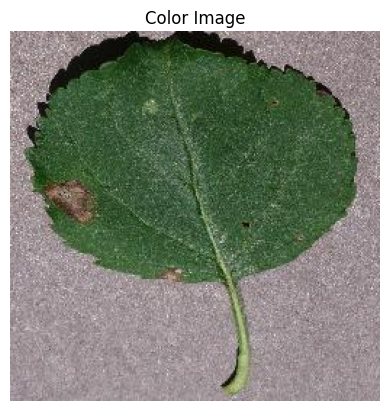

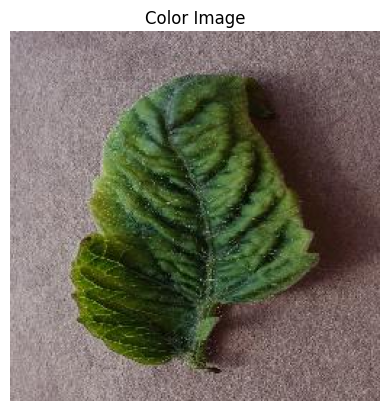

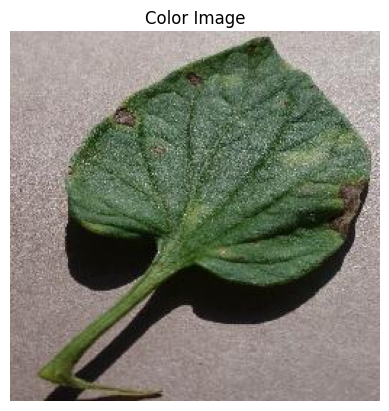

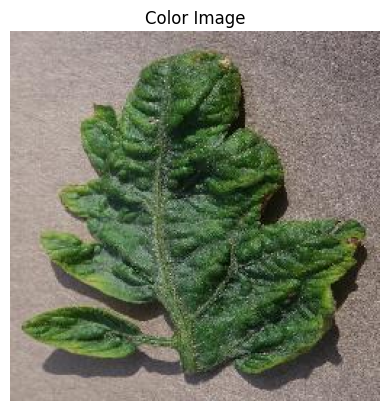

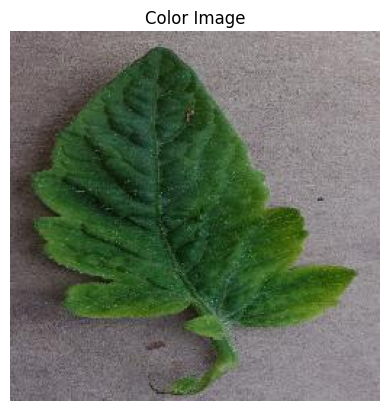

...

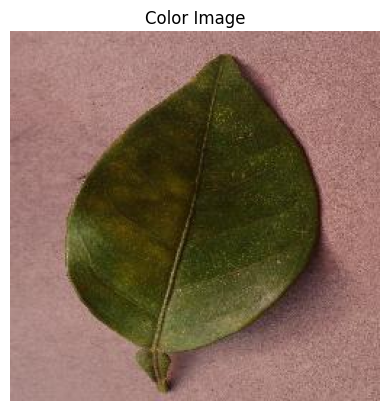

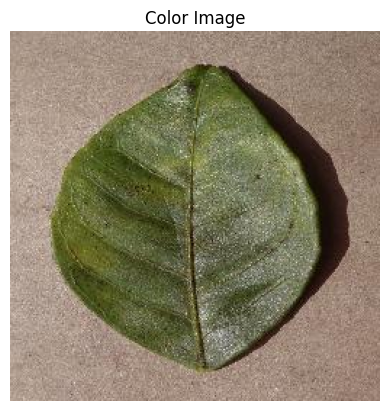

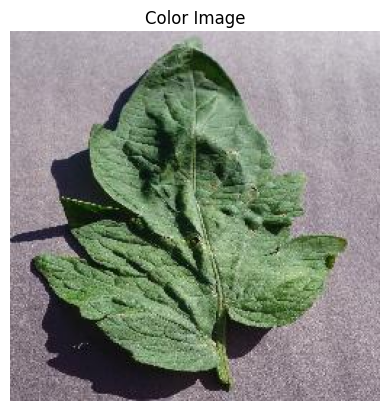

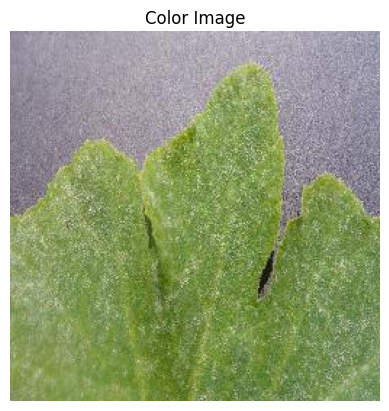

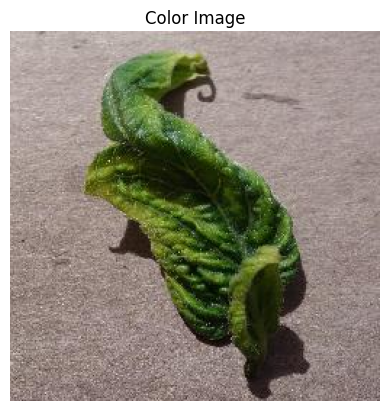

In [10]:
import matplotlib.pyplot as plt

for i in range(len(batch_images_color)):
    img_color = batch_images_color[i]

    
    # Display color image
    plt.imshow(img_color)
    plt.title("Color Image")
    plt.axis('off')
    plt.show()

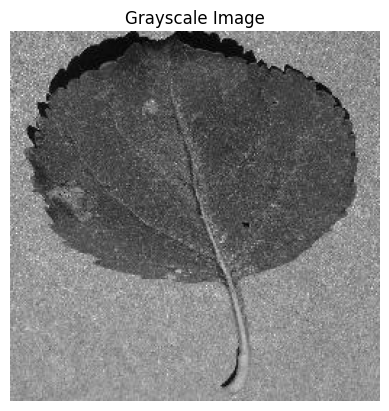

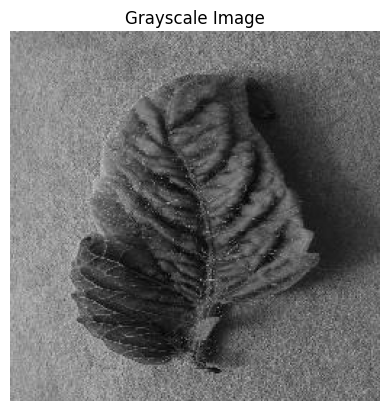

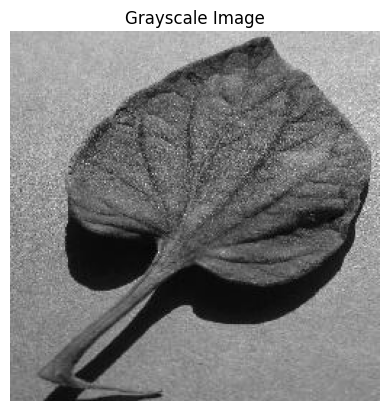

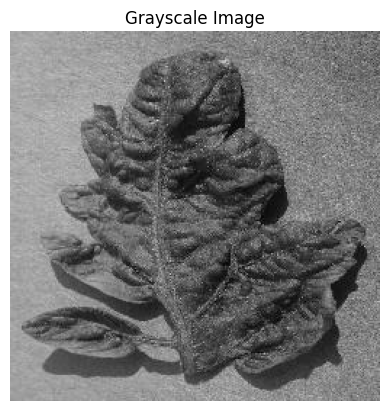

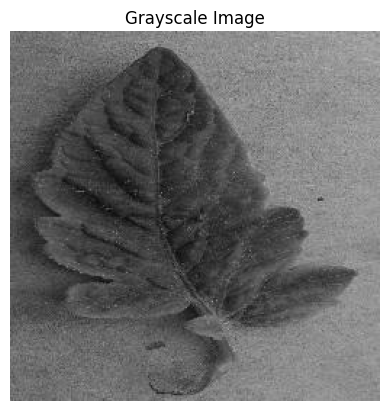

...

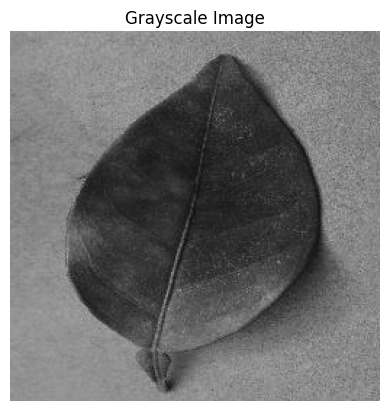

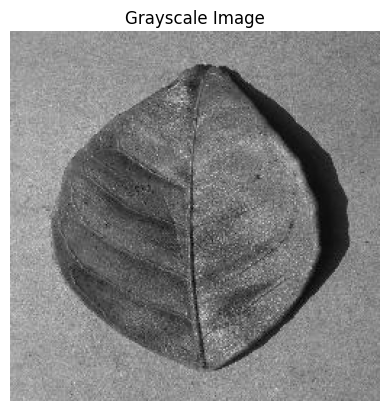

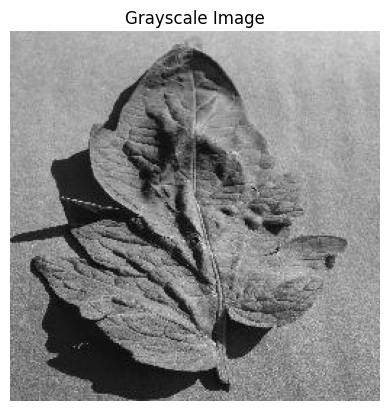

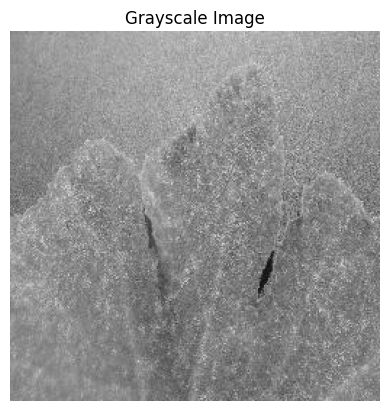

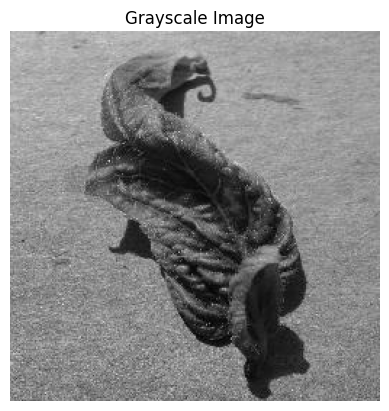

In [11]:
import matplotlib.pyplot as plt

for i in range(len(batch_images_gray)):
    
    img_gray = batch_images_gray[i]
    
    
    # Display grayscale image
    plt.imshow(img_gray.squeeze(), cmap='gray')
    plt.title("Grayscale Image")
    plt.axis('off')
    plt.show()

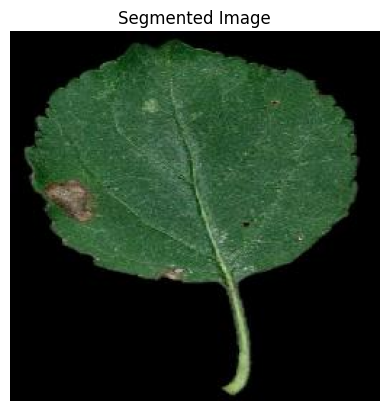

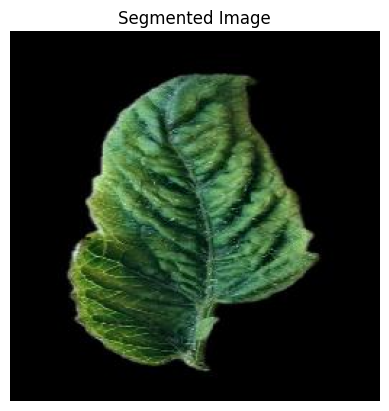

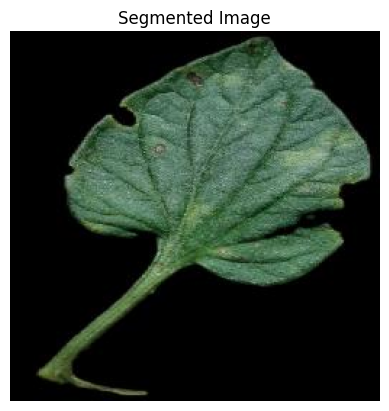

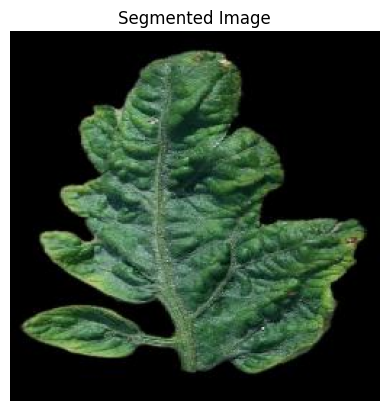

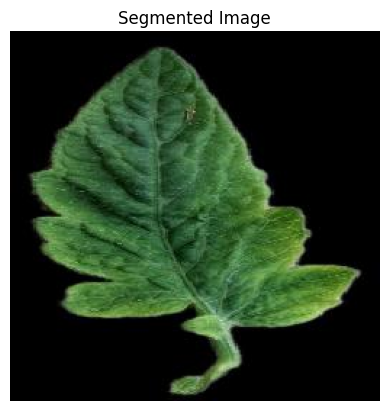

...

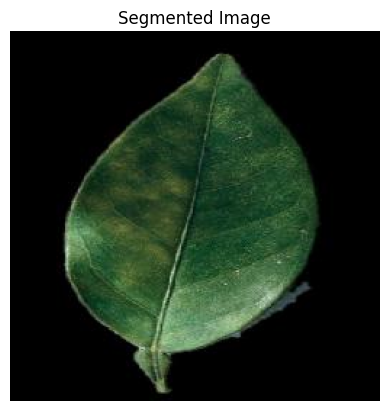

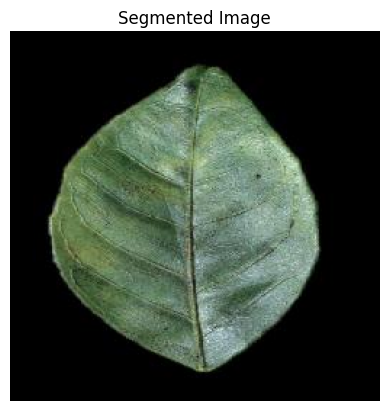

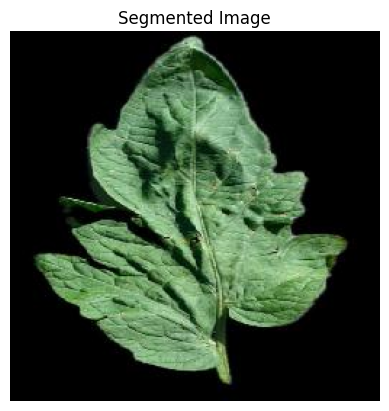

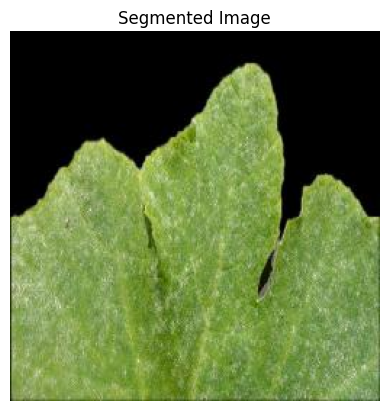

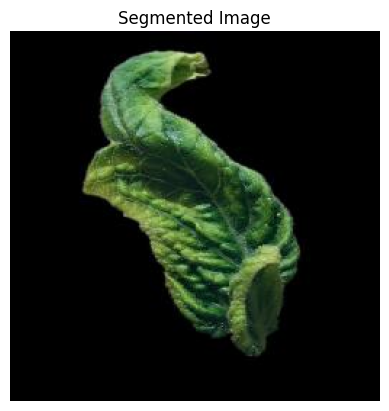

In [12]:

import matplotlib.pyplot as plt

for i in range(len(batch_images_segmented)):
    
    img_segmented = batch_images_segmented[i]
    
    
    # Display grayscale image
    plt.imshow(img_segmented)
    plt.title("Segmented Image")
    plt.axis('off')
    plt.show()

In [13]:
inception_preds_color = inception_color_model.predict(batch_images_color)
vgg16_preds_color = vgg_color_model.predict(batch_images_color)
ensemble_preds_color = (inception_preds_color + vgg16_preds_color) / 2
ensemble_predicted_classes_color = np.argmax(ensemble_preds_color, axis=1)

In [14]:
inception_preds_grayscale = inception_gray_model.predict(batch_images_gray)
vgg16_preds_grayscale = vgg_gray_model.predict(batch_images_gray)
ensemble_preds_grayscale = (inception_preds_grayscale + vgg16_preds_grayscale) / 2
ensemble_predicted_classes_grayscale = np.argmax(ensemble_preds_grayscale, axis=1)

In [15]:
inception_preds_segmented = inception_segmented_model.predict(batch_images_segmented)
vgg16_preds_segmented = vgg_segmented_model.predict(batch_images_segmented)
ensemble_preds_segmented = (inception_preds_segmented + vgg16_preds_segmented) / 2
ensemble_predicted_classes_segmented = np.argmax(ensemble_preds_segmented, axis=1)

In [17]:
from scipy.stats import mode

# Stack the predictions from all three ensembled models vertically
ensemble_predictions = np.vstack((ensemble_predicted_classes_color,
                                  ensemble_predicted_classes_grayscale,
                                  ensemble_predicted_classes_segmented))

# Take the mode (most common prediction) along the columns (axis=0)
final_predictions = mode(ensemble_predictions, axis=0).mode[0]

# Final predictions using voting ensemble
print("Final Predictions using Voting Ensemble:", final_predictions)


Final Predictions using Voting Ensemble: [ 1 35 30 35 31 35  9 12 20 35  8 35 35 21  8 35 10 15 21 29 35 24  4 34
  5 15 26 15 15 34 25 35]


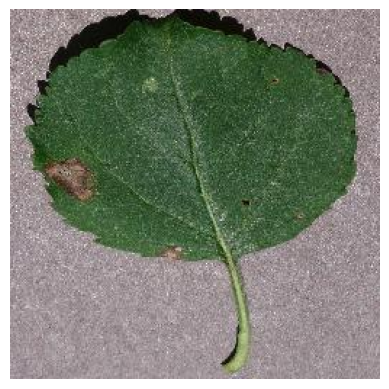

Actual Class: Apple___Black_rot
Final Prediction: Apple___Black_rot


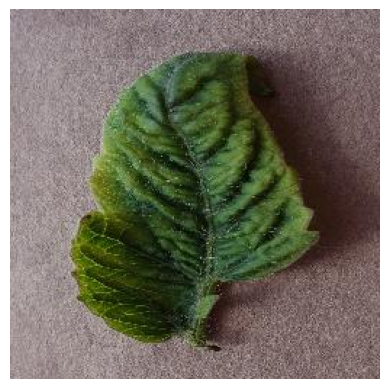

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


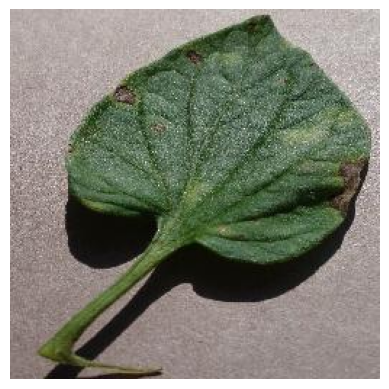

Actual Class: Tomato___Early_blight
Final Prediction: Tomato___Late_blight


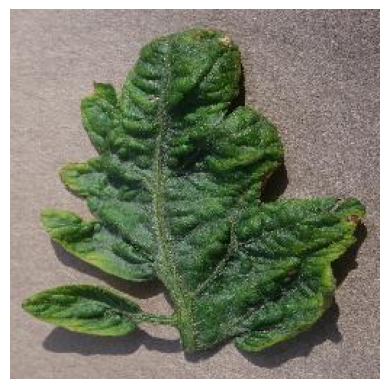

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


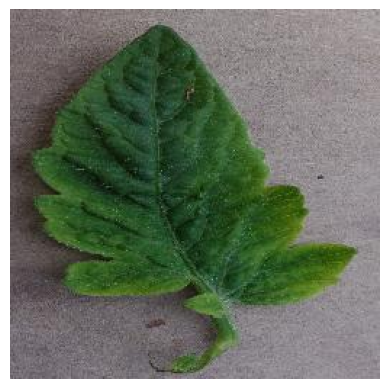

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Leaf_Mold


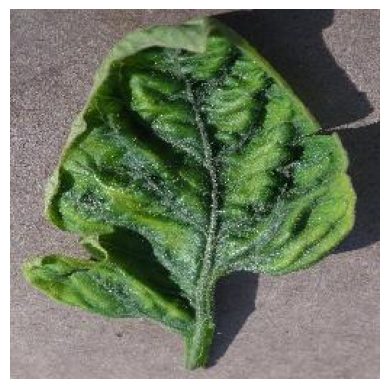

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


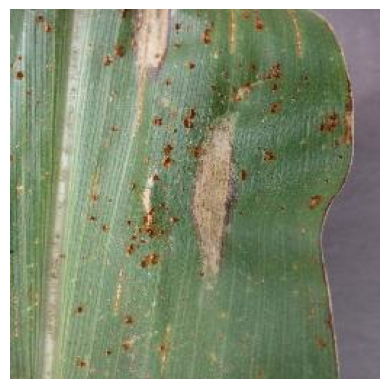

Actual Class: Corn_(maize)___Northern_Leaf_Blight
Final Prediction: Corn_(maize)___Northern_Leaf_Blight


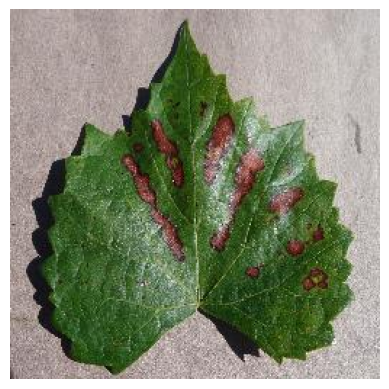

Actual Class: Grape___Esca_(Black_Measles)
Final Prediction: Grape___Esca_(Black_Measles)


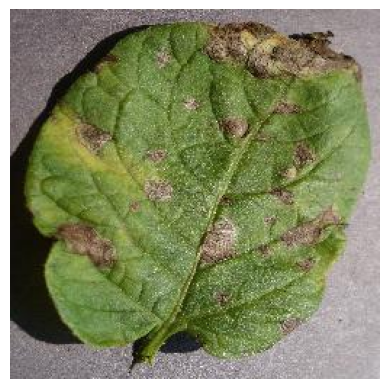

Actual Class: Potato___Early_blight
Final Prediction: Potato___Early_blight


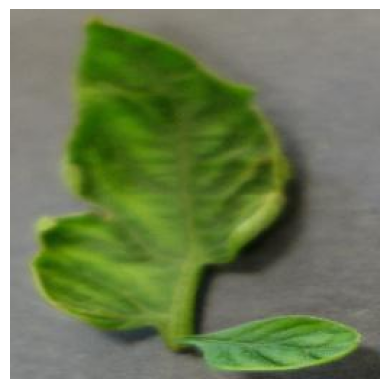

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


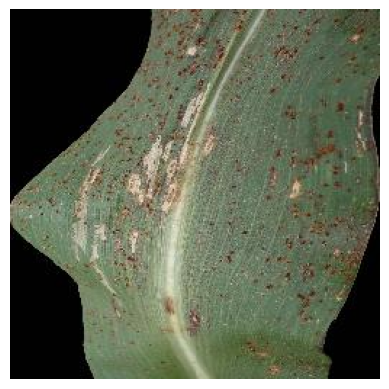

Actual Class: Corn_(maize)___Common_rust_
Final Prediction: Corn_(maize)___Common_rust_


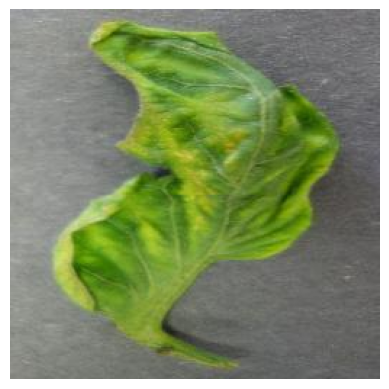

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


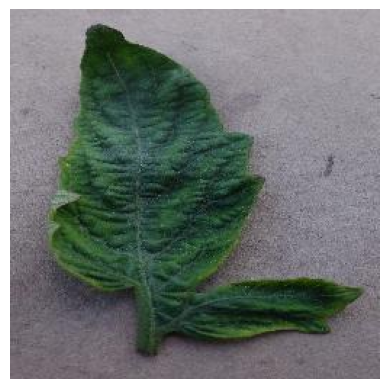

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


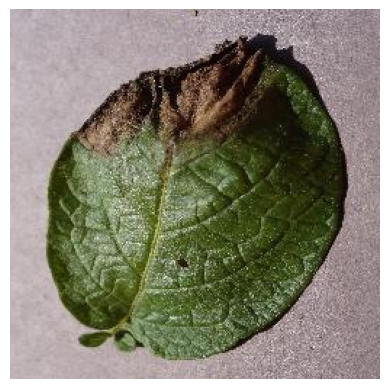

Actual Class: Potato___Late_blight
Final Prediction: Potato___Late_blight


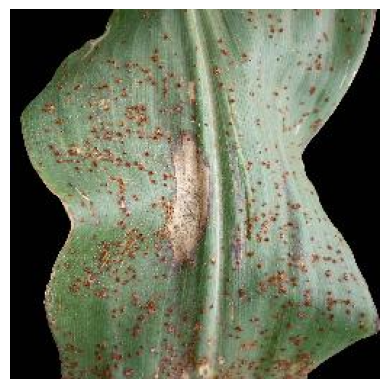

Actual Class: Corn_(maize)___Common_rust_
Final Prediction: Corn_(maize)___Common_rust_


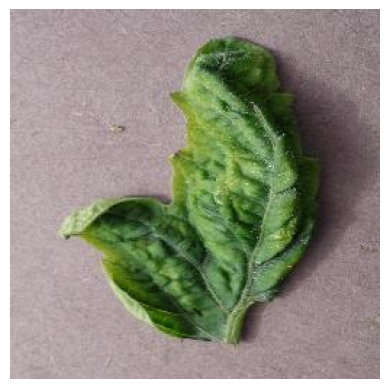

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


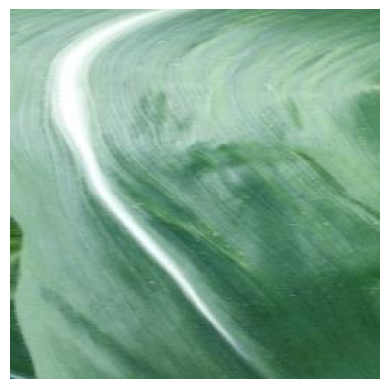

Actual Class: Corn_(maize)___healthy
Final Prediction: Corn_(maize)___healthy


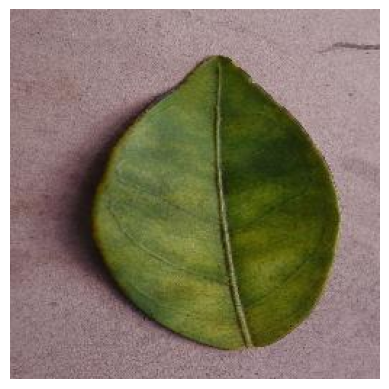

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Final Prediction: Orange___Haunglongbing_(Citrus_greening)


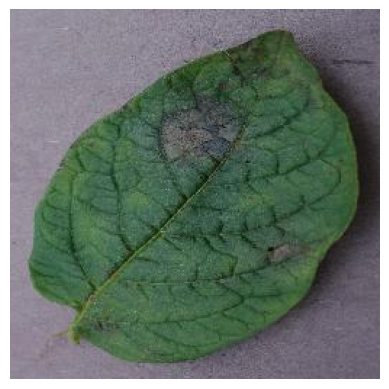

Actual Class: Potato___Late_blight
Final Prediction: Potato___Late_blight


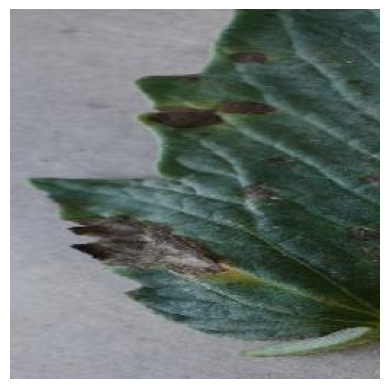

Actual Class: Tomato___Early_blight
Final Prediction: Tomato___Early_blight


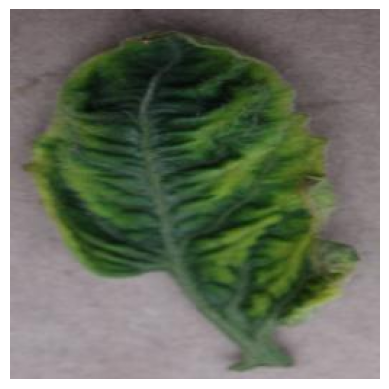

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


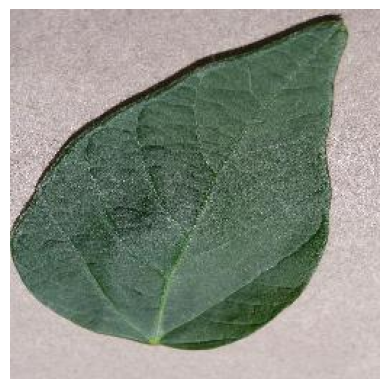

Actual Class: Soybean___healthy
Final Prediction: Soybean___healthy


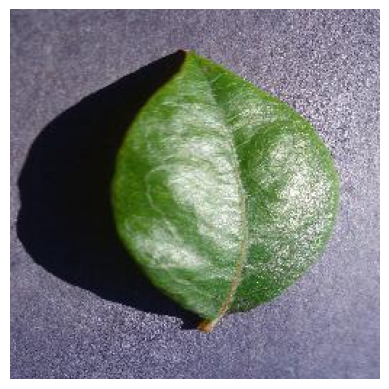

Actual Class: Blueberry___healthy
Final Prediction: Blueberry___healthy


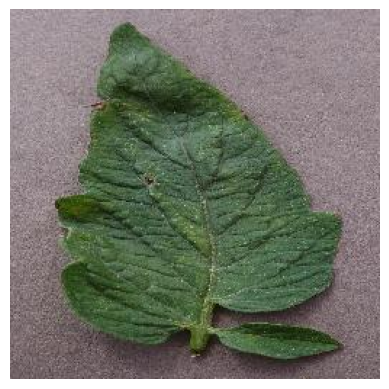

Actual Class: Tomato___Target_Spot
Final Prediction: Tomato___Target_Spot


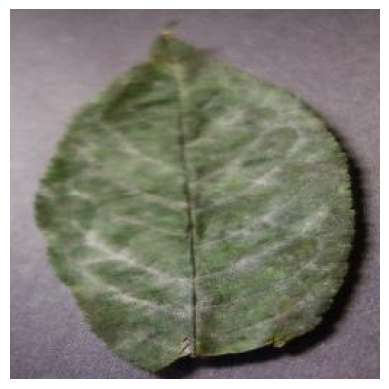

Actual Class: Cherry_(including_sour)___Powdery_mildew
Final Prediction: Cherry_(including_sour)___Powdery_mildew


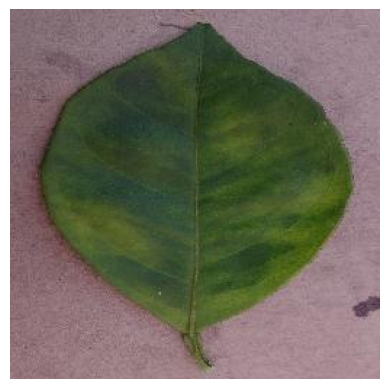

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Final Prediction: Orange___Haunglongbing_(Citrus_greening)


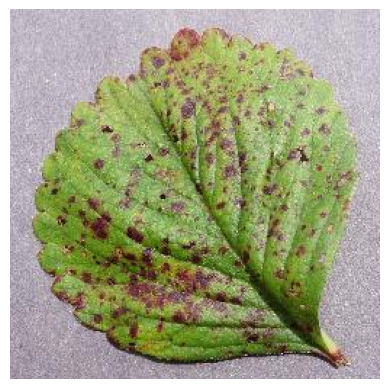

Actual Class: Strawberry___Leaf_scorch
Final Prediction: Strawberry___Leaf_scorch


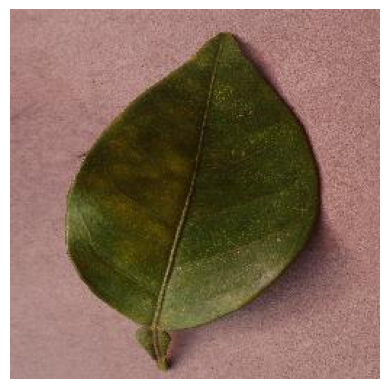

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Final Prediction: Orange___Haunglongbing_(Citrus_greening)


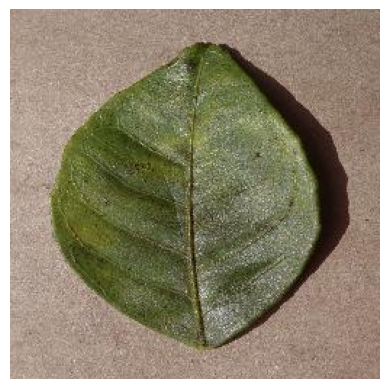

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Final Prediction: Orange___Haunglongbing_(Citrus_greening)


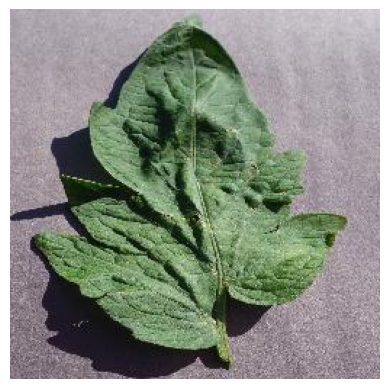

Actual Class: Tomato___Target_Spot
Final Prediction: Tomato___Target_Spot


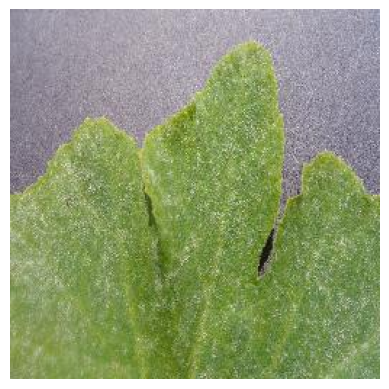

Actual Class: Squash___Powdery_mildew
Final Prediction: Squash___Powdery_mildew


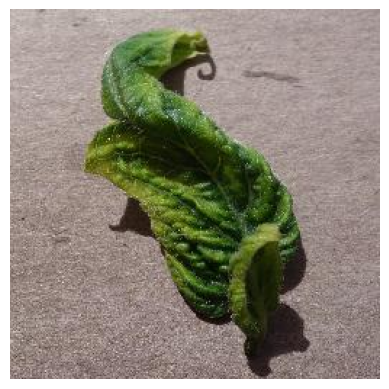

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


In [18]:
import matplotlib.pyplot as plt

# Iterate over each image, its actual class label, and its corresponding final prediction
for image, actual_label, prediction in zip(batch_images_color, batch_labels_color, final_predictions):
    # Display the image
    plt.imshow(image)
    plt.axis('off')
    plt.show()
    
    # Get the actual class label
    actual_class = class_names[np.argmax(actual_label)]
    
    # Display the actual class label and the final prediction
    print("Actual Class:", actual_class)
    print("Final Prediction:", class_names[prediction])

In [19]:
from sklearn.metrics import accuracy_score

# Convert the final predictions to numpy array
final_predictions_array = np.array(final_predictions)

# Get the actual class labels as indices
actual_labels_indices = np.argmax(batch_labels_color, axis=1)

# Calculate the accuracy of the final predictions
accuracy = accuracy_score(actual_labels_indices, final_predictions_array)

# Print the accuracy
print("Accuracy of Final Predictions:", accuracy)

Accuracy of Final Predictions: 0.9375


In [20]:
from scipy.stats import mode

# Stack the predictions from all three ensembled models vertically
ensemble_predictions = np.vstack((ensemble_predicted_classes_color,
                                  ensemble_predicted_classes_grayscale,
                                  ensemble_predicted_classes_segmented))

# Take the mode (most common prediction) along the columns (axis=0)
final_predictions = mode(ensemble_predictions, axis=0).mode[0]



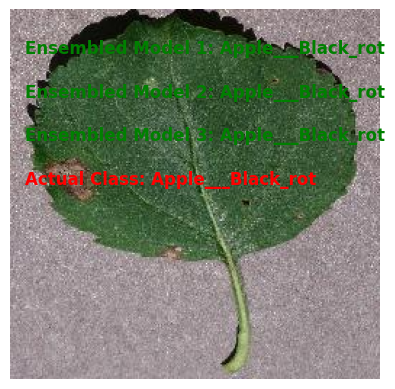

Final Ensembled Prediction: Apple___Black_rot


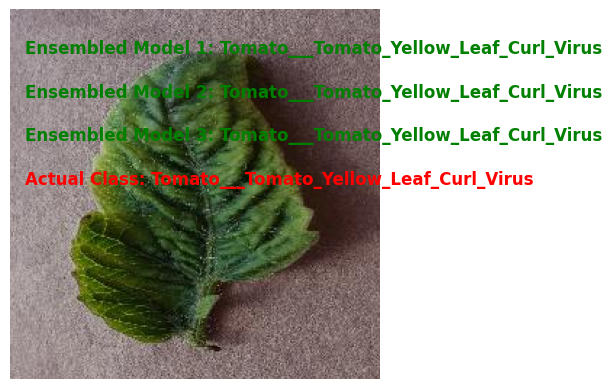

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


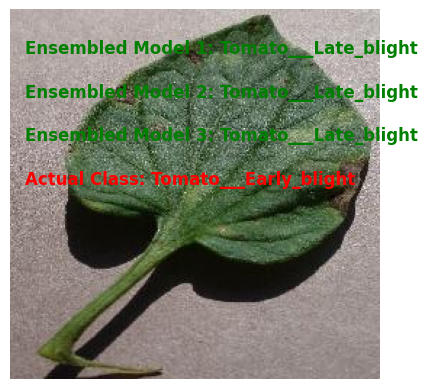

Final Ensembled Prediction: Tomato___Late_blight


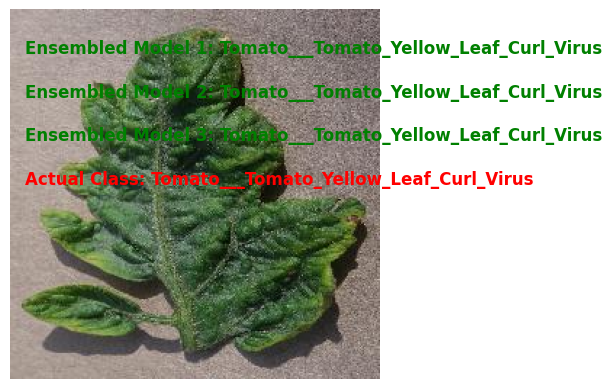

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


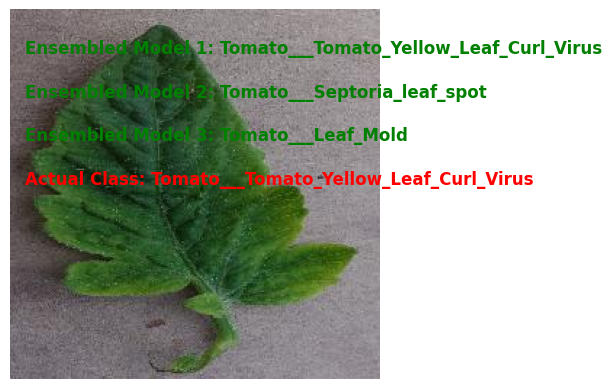

Final Ensembled Prediction: Tomato___Leaf_Mold


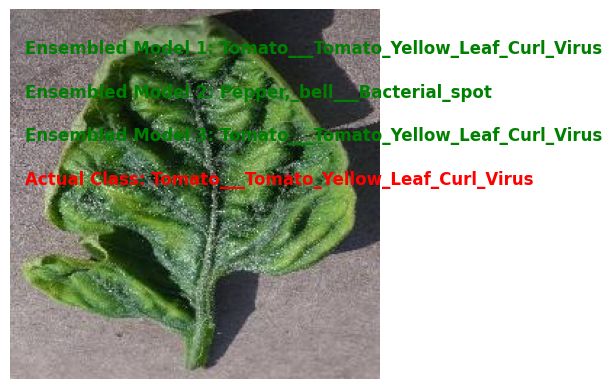

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


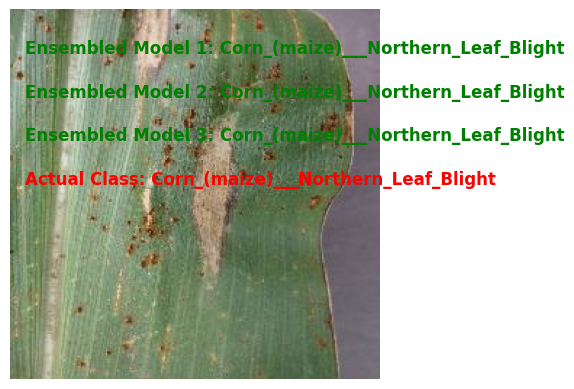

Final Ensembled Prediction: Corn_(maize)___Northern_Leaf_Blight


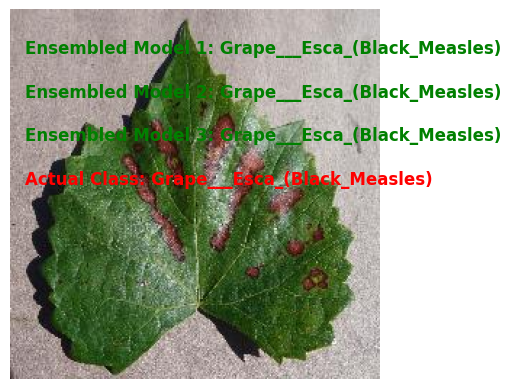

Final Ensembled Prediction: Grape___Esca_(Black_Measles)


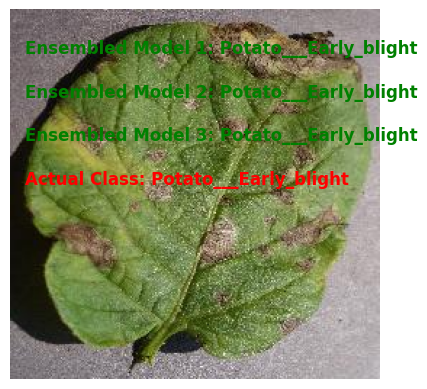

Final Ensembled Prediction: Potato___Early_blight


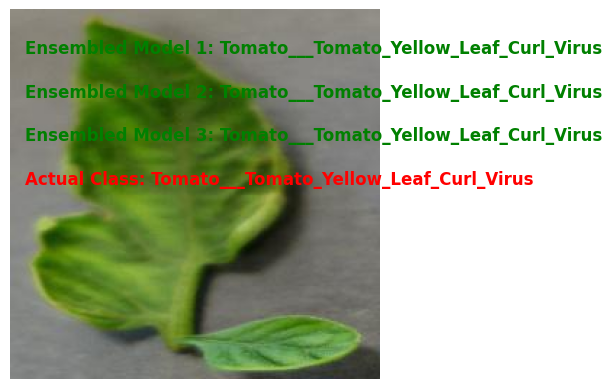

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


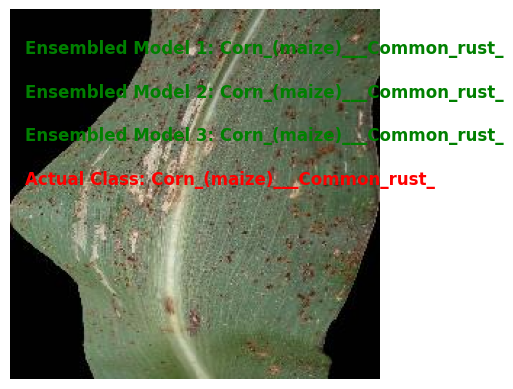

Final Ensembled Prediction: Corn_(maize)___Common_rust_


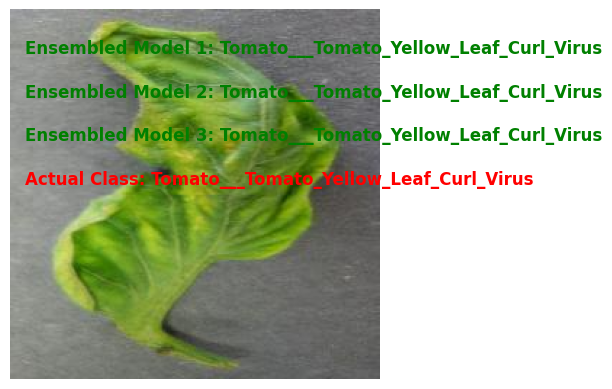

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


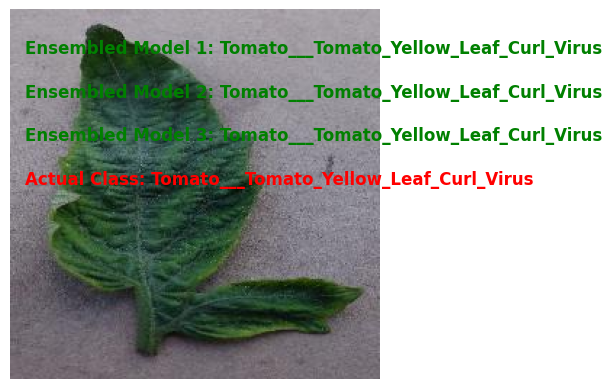

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


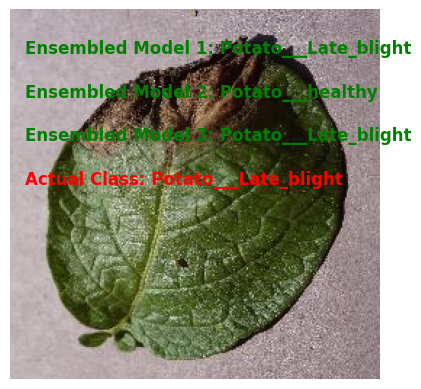

Final Ensembled Prediction: Potato___Late_blight


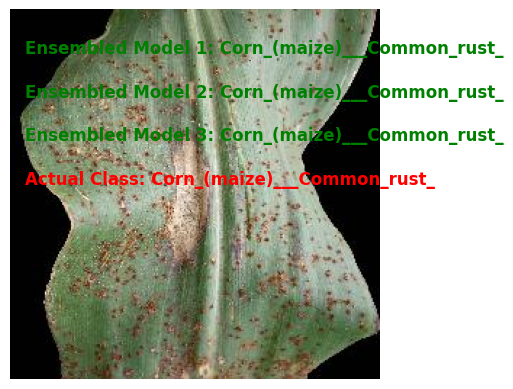

Final Ensembled Prediction: Corn_(maize)___Common_rust_


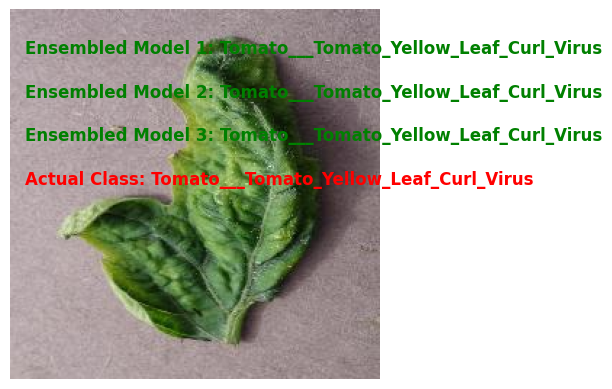

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


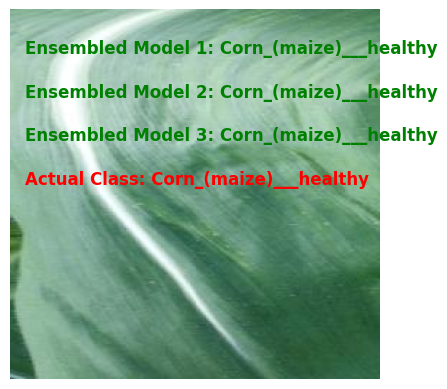

Final Ensembled Prediction: Corn_(maize)___healthy


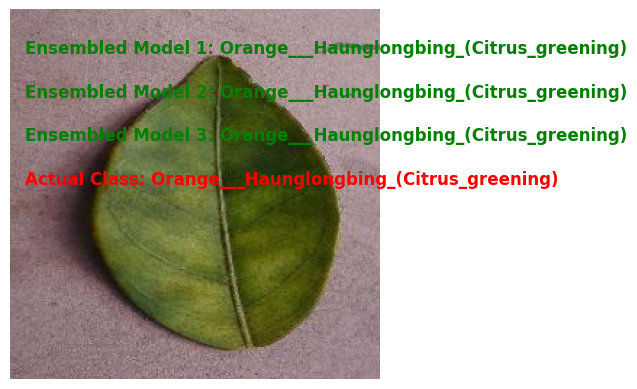

Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


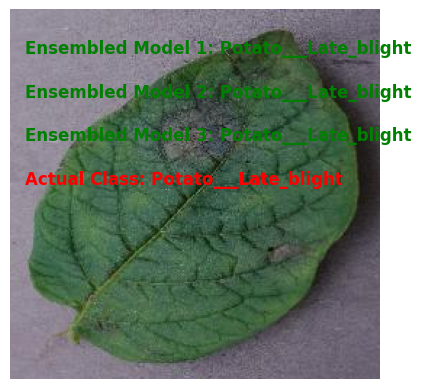

Final Ensembled Prediction: Potato___Late_blight


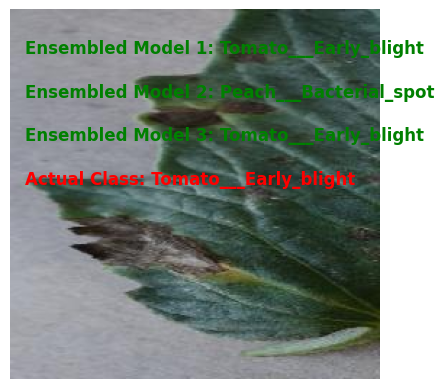

Final Ensembled Prediction: Tomato___Early_blight


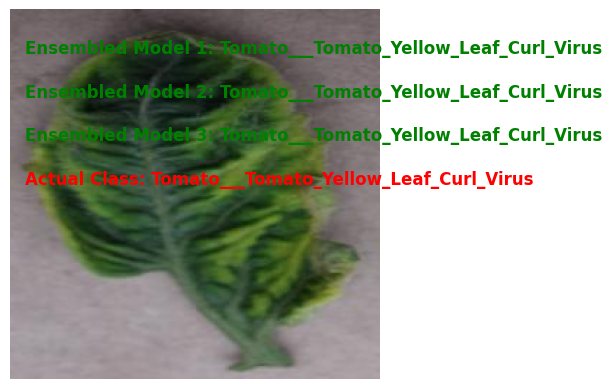

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


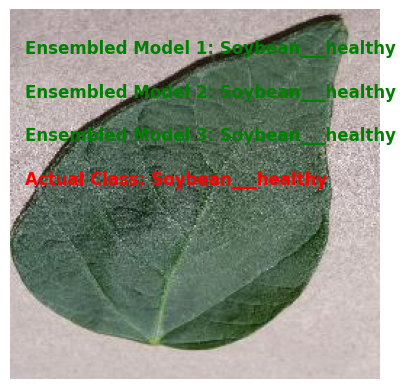

Final Ensembled Prediction: Soybean___healthy


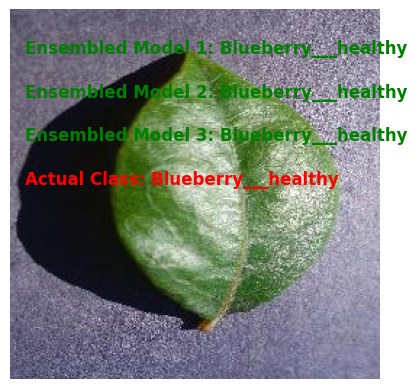

Final Ensembled Prediction: Blueberry___healthy


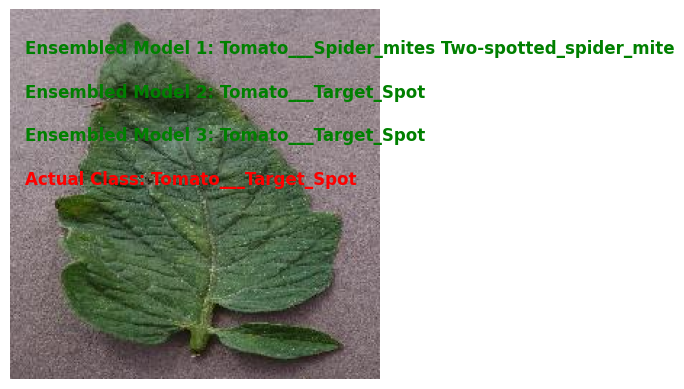

Final Ensembled Prediction: Tomato___Target_Spot


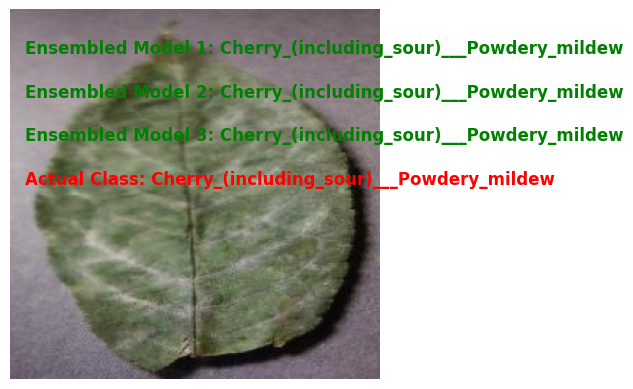

Final Ensembled Prediction: Cherry_(including_sour)___Powdery_mildew


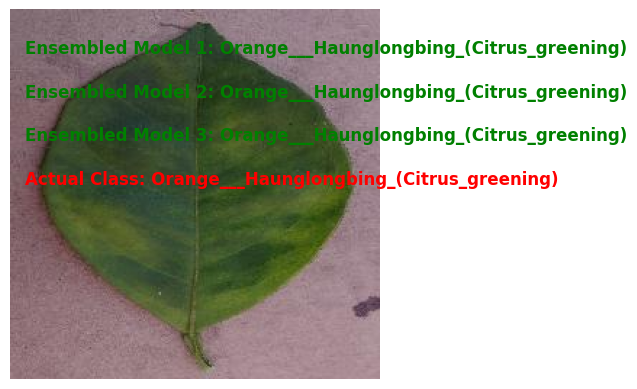

Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


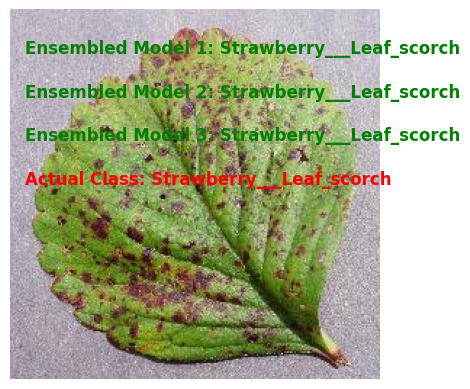

Final Ensembled Prediction: Strawberry___Leaf_scorch


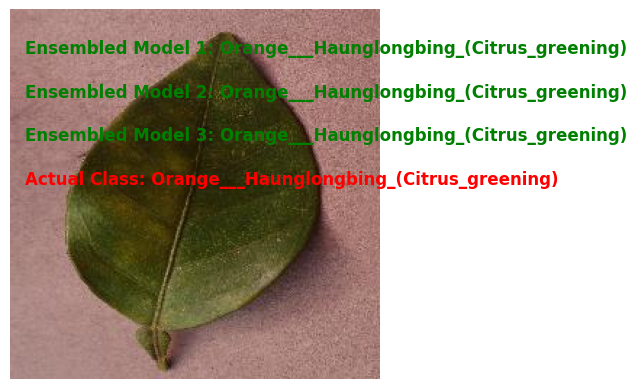

Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


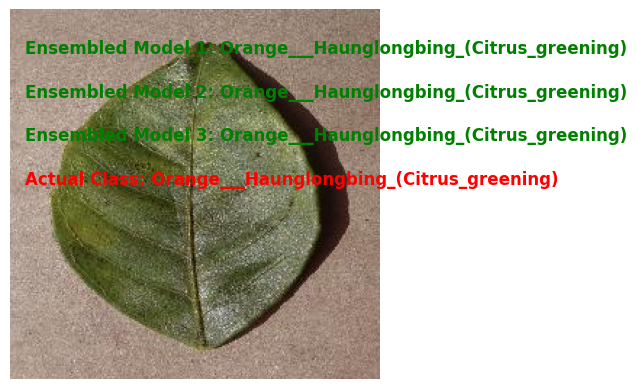

Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


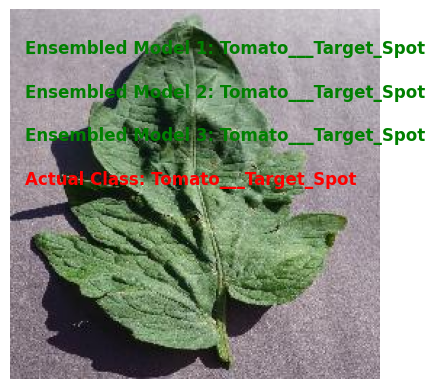

Final Ensembled Prediction: Tomato___Target_Spot


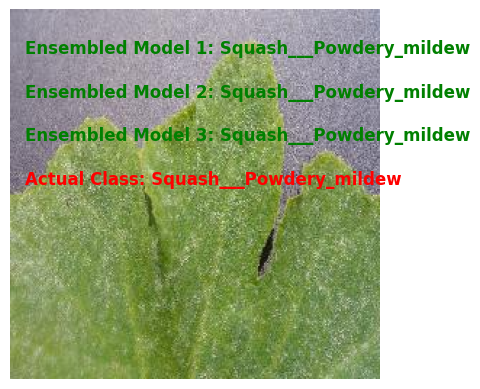

Final Ensembled Prediction: Squash___Powdery_mildew


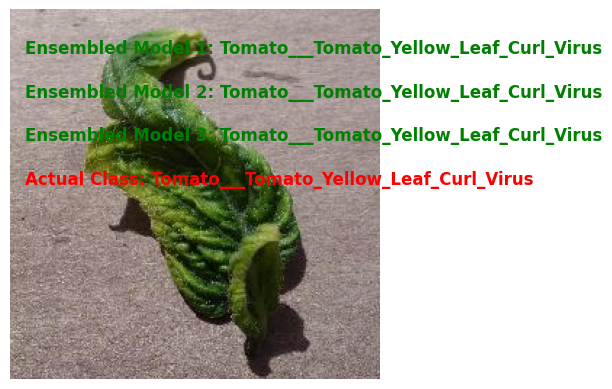

Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


In [21]:

import matplotlib.pyplot as plt

# Define a function to plot an image with predictions
def plot_image_with_predictions(image, predictions, actual_class):
    plt.imshow(image)
    plt.axis('off')
    
    # Add text annotations for predictions
    for i, prediction in enumerate(predictions):
        plt.text(10, 30 + i * 30, f"Ensembled Model {i+1}: {class_names[prediction]}", color='green', fontsize=12, weight='bold')
    
    # Add text annotation for actual class label
    plt.text(10, 30 + len(predictions) * 30, f"Actual Class: {actual_class}", color='red', fontsize=12, weight='bold')
    
    plt.show()

# Iterate over each image, its actual class label, and its corresponding predictions of ensembled models
for image, actual_label, prediction_color, prediction_gray, prediction_segmented, final_prediction in zip(batch_images_color, batch_labels_color, ensemble_predicted_classes_color, ensemble_predicted_classes_grayscale, ensemble_predicted_classes_segmented, final_predictions):
    # Display the image with predictions
    plot_image_with_predictions(image, [prediction_color, prediction_gray, prediction_segmented], class_names[np.argmax(actual_label)])
    
    # Display the final ensembled prediction
    print("Final Ensembled Prediction:", class_names[final_prediction])

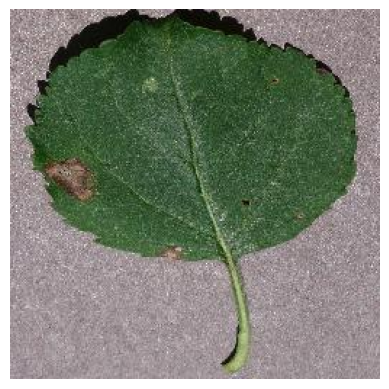

Actual Class: Apple___Black_rot
Predictions of Color Ensembled Model: Apple___Black_rot
Predictions of Grayscale Ensembled Model: Apple___Black_rot
Predictions of Segmented Ensembled Model: Apple___Black_rot
Final Ensembled Prediction: Apple___Black_rot


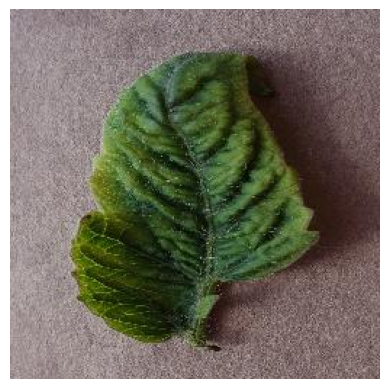

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


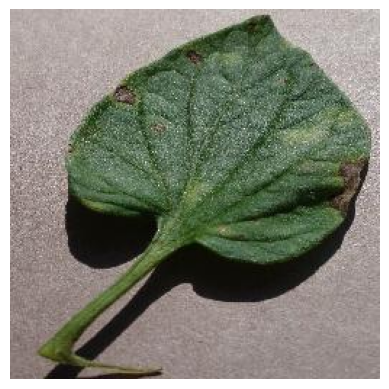

Actual Class: Tomato___Early_blight
Predictions of Color Ensembled Model: Tomato___Late_blight
Predictions of Grayscale Ensembled Model: Tomato___Late_blight
Predictions of Segmented Ensembled Model: Tomato___Late_blight
Final Ensembled Prediction: Tomato___Late_blight


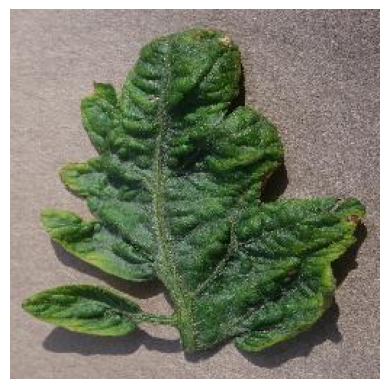

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


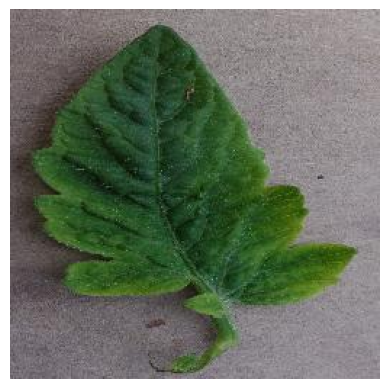

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Septoria_leaf_spot
Predictions of Segmented Ensembled Model: Tomato___Leaf_Mold
Final Ensembled Prediction: Tomato___Leaf_Mold


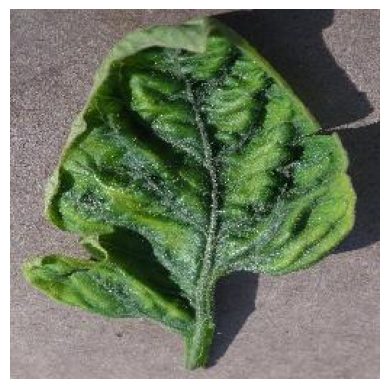

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Pepper,_bell___Bacterial_spot
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


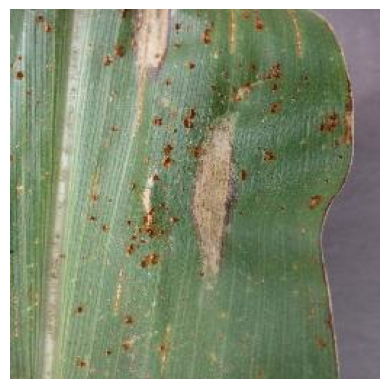

Actual Class: Corn_(maize)___Northern_Leaf_Blight
Predictions of Color Ensembled Model: Corn_(maize)___Northern_Leaf_Blight
Predictions of Grayscale Ensembled Model: Corn_(maize)___Northern_Leaf_Blight
Predictions of Segmented Ensembled Model: Corn_(maize)___Northern_Leaf_Blight
Final Ensembled Prediction: Corn_(maize)___Northern_Leaf_Blight


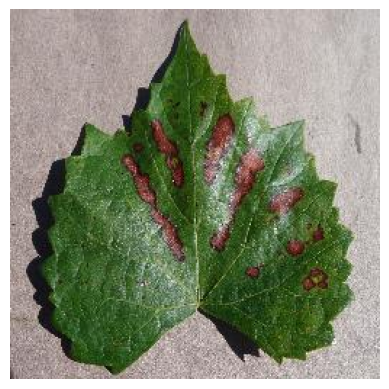

Actual Class: Grape___Esca_(Black_Measles)
Predictions of Color Ensembled Model: Grape___Esca_(Black_Measles)
Predictions of Grayscale Ensembled Model: Grape___Esca_(Black_Measles)
Predictions of Segmented Ensembled Model: Grape___Esca_(Black_Measles)
Final Ensembled Prediction: Grape___Esca_(Black_Measles)


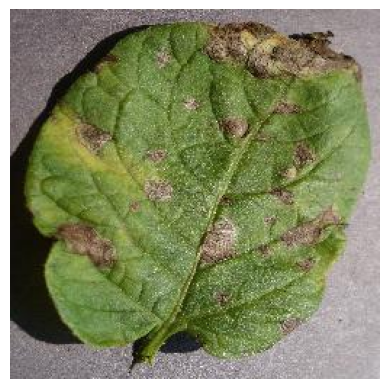

Actual Class: Potato___Early_blight
Predictions of Color Ensembled Model: Potato___Early_blight
Predictions of Grayscale Ensembled Model: Potato___Early_blight
Predictions of Segmented Ensembled Model: Potato___Early_blight
Final Ensembled Prediction: Potato___Early_blight


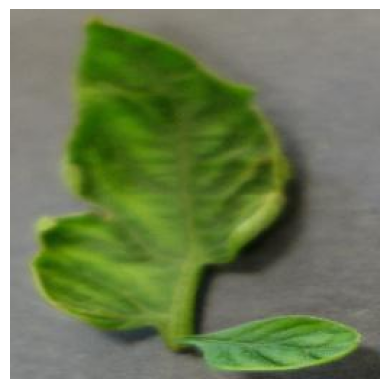

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


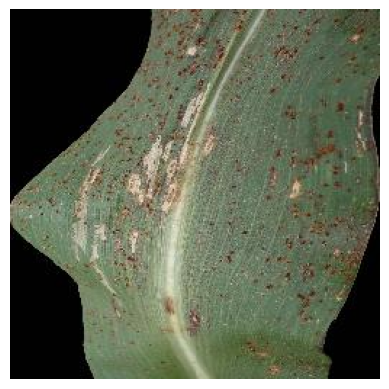

Actual Class: Corn_(maize)___Common_rust_
Predictions of Color Ensembled Model: Corn_(maize)___Common_rust_
Predictions of Grayscale Ensembled Model: Corn_(maize)___Common_rust_
Predictions of Segmented Ensembled Model: Corn_(maize)___Common_rust_
Final Ensembled Prediction: Corn_(maize)___Common_rust_


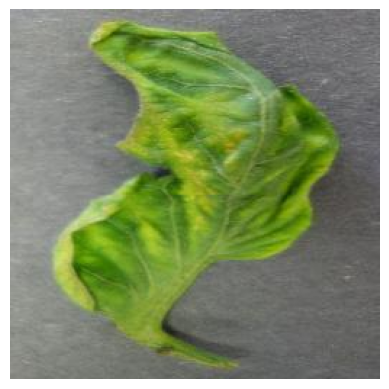

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


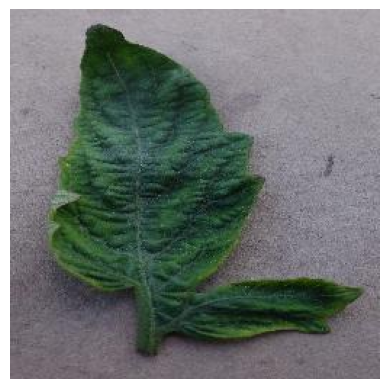

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


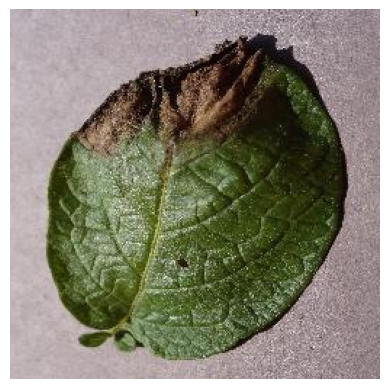

Actual Class: Potato___Late_blight
Predictions of Color Ensembled Model: Potato___Late_blight
Predictions of Grayscale Ensembled Model: Potato___healthy
Predictions of Segmented Ensembled Model: Potato___Late_blight
Final Ensembled Prediction: Potato___Late_blight


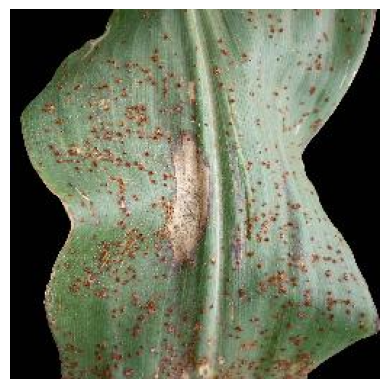

Actual Class: Corn_(maize)___Common_rust_
Predictions of Color Ensembled Model: Corn_(maize)___Common_rust_
Predictions of Grayscale Ensembled Model: Corn_(maize)___Common_rust_
Predictions of Segmented Ensembled Model: Corn_(maize)___Common_rust_
Final Ensembled Prediction: Corn_(maize)___Common_rust_


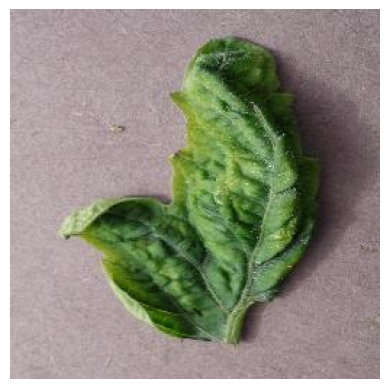

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


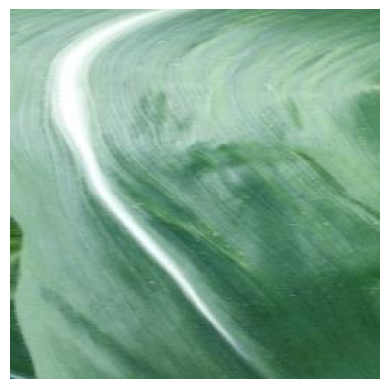

Actual Class: Corn_(maize)___healthy
Predictions of Color Ensembled Model: Corn_(maize)___healthy
Predictions of Grayscale Ensembled Model: Corn_(maize)___healthy
Predictions of Segmented Ensembled Model: Corn_(maize)___healthy
Final Ensembled Prediction: Corn_(maize)___healthy


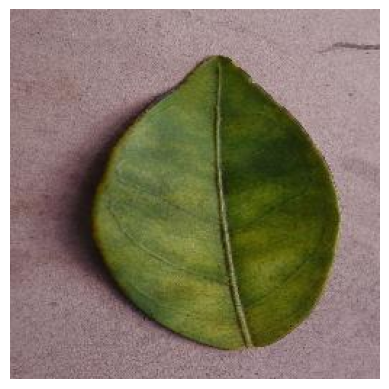

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Predictions of Color Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Grayscale Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Segmented Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


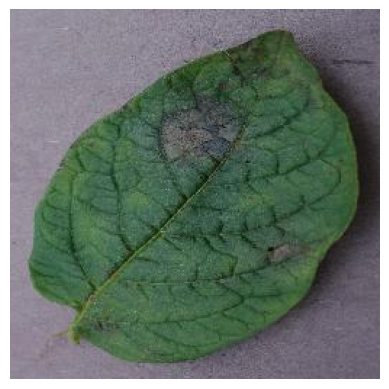

Actual Class: Potato___Late_blight
Predictions of Color Ensembled Model: Potato___Late_blight
Predictions of Grayscale Ensembled Model: Potato___Late_blight
Predictions of Segmented Ensembled Model: Potato___Late_blight
Final Ensembled Prediction: Potato___Late_blight


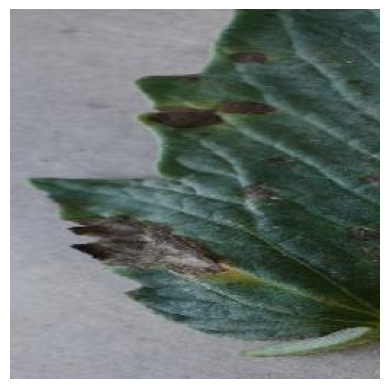

Actual Class: Tomato___Early_blight
Predictions of Color Ensembled Model: Tomato___Early_blight
Predictions of Grayscale Ensembled Model: Peach___Bacterial_spot
Predictions of Segmented Ensembled Model: Tomato___Early_blight
Final Ensembled Prediction: Tomato___Early_blight


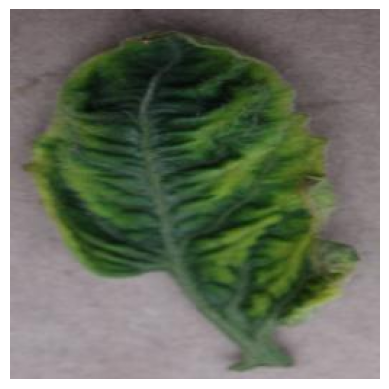

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


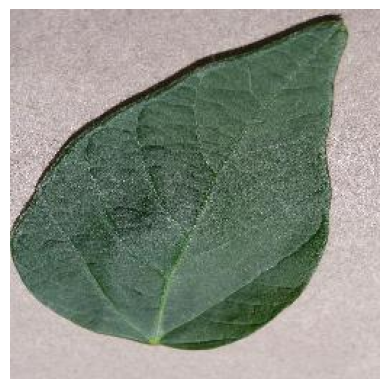

Actual Class: Soybean___healthy
Predictions of Color Ensembled Model: Soybean___healthy
Predictions of Grayscale Ensembled Model: Soybean___healthy
Predictions of Segmented Ensembled Model: Soybean___healthy
Final Ensembled Prediction: Soybean___healthy


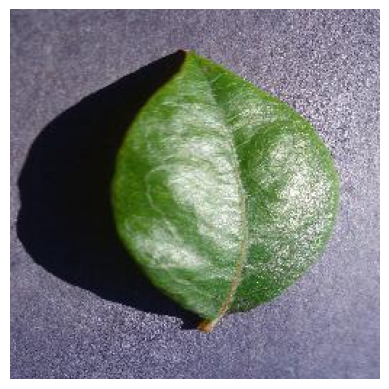

Actual Class: Blueberry___healthy
Predictions of Color Ensembled Model: Blueberry___healthy
Predictions of Grayscale Ensembled Model: Blueberry___healthy
Predictions of Segmented Ensembled Model: Blueberry___healthy
Final Ensembled Prediction: Blueberry___healthy


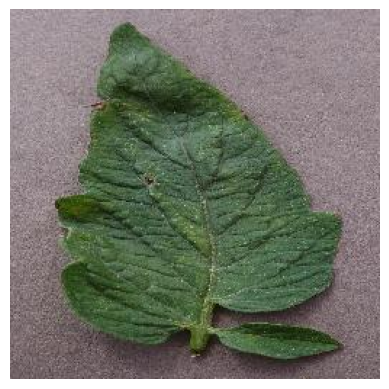

Actual Class: Tomato___Target_Spot
Predictions of Color Ensembled Model: Tomato___Spider_mites Two-spotted_spider_mite
Predictions of Grayscale Ensembled Model: Tomato___Target_Spot
Predictions of Segmented Ensembled Model: Tomato___Target_Spot
Final Ensembled Prediction: Tomato___Target_Spot


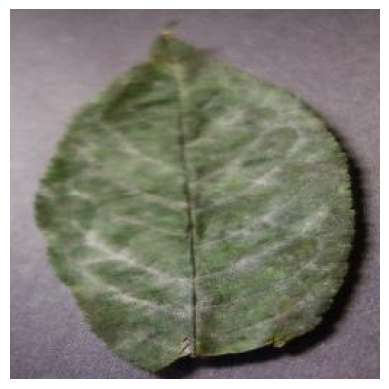

Actual Class: Cherry_(including_sour)___Powdery_mildew
Predictions of Color Ensembled Model: Cherry_(including_sour)___Powdery_mildew
Predictions of Grayscale Ensembled Model: Cherry_(including_sour)___Powdery_mildew
Predictions of Segmented Ensembled Model: Cherry_(including_sour)___Powdery_mildew
Final Ensembled Prediction: Cherry_(including_sour)___Powdery_mildew


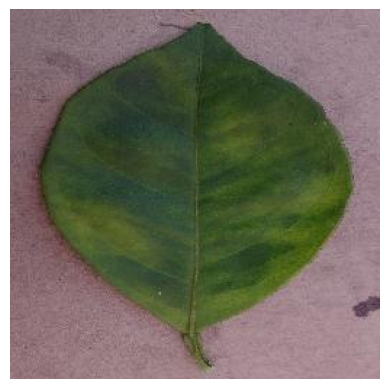

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Predictions of Color Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Grayscale Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Segmented Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


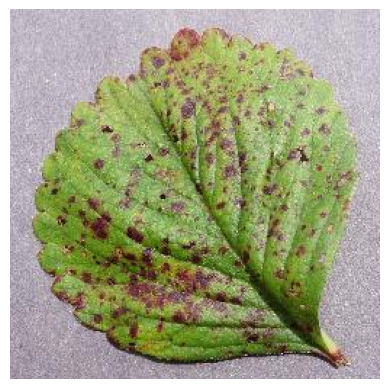

Actual Class: Strawberry___Leaf_scorch
Predictions of Color Ensembled Model: Strawberry___Leaf_scorch
Predictions of Grayscale Ensembled Model: Strawberry___Leaf_scorch
Predictions of Segmented Ensembled Model: Strawberry___Leaf_scorch
Final Ensembled Prediction: Strawberry___Leaf_scorch


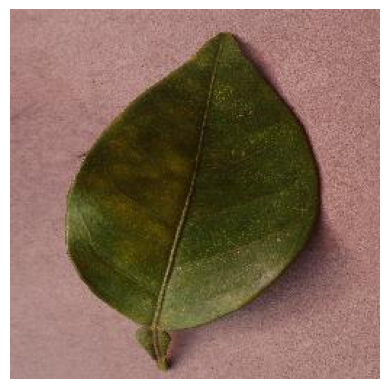

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Predictions of Color Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Grayscale Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Segmented Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


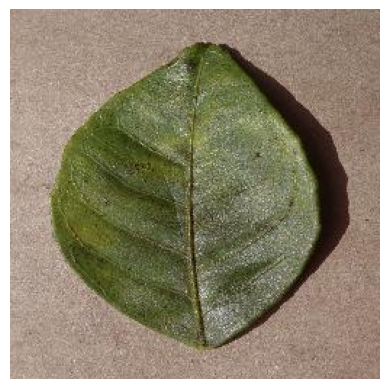

Actual Class: Orange___Haunglongbing_(Citrus_greening)
Predictions of Color Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Grayscale Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Predictions of Segmented Ensembled Model: Orange___Haunglongbing_(Citrus_greening)
Final Ensembled Prediction: Orange___Haunglongbing_(Citrus_greening)


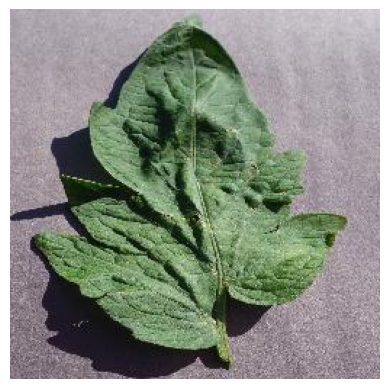

Actual Class: Tomato___Target_Spot
Predictions of Color Ensembled Model: Tomato___Target_Spot
Predictions of Grayscale Ensembled Model: Tomato___Target_Spot
Predictions of Segmented Ensembled Model: Tomato___Target_Spot
Final Ensembled Prediction: Tomato___Target_Spot


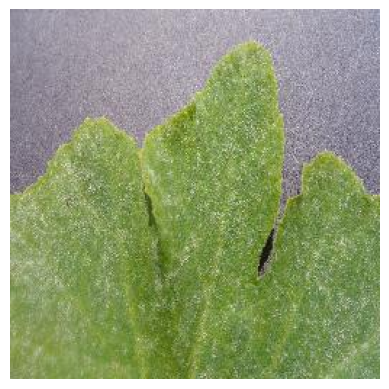

Actual Class: Squash___Powdery_mildew
Predictions of Color Ensembled Model: Squash___Powdery_mildew
Predictions of Grayscale Ensembled Model: Squash___Powdery_mildew
Predictions of Segmented Ensembled Model: Squash___Powdery_mildew
Final Ensembled Prediction: Squash___Powdery_mildew


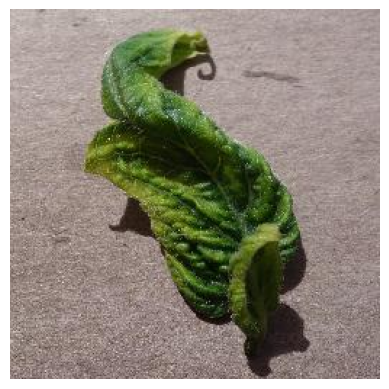

Actual Class: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Color Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Grayscale Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Predictions of Segmented Ensembled Model: Tomato___Tomato_Yellow_Leaf_Curl_Virus
Final Ensembled Prediction: Tomato___Tomato_Yellow_Leaf_Curl_Virus


In [23]:
import matplotlib.pyplot as plt

# Iterate over each image, its actual class label, and its corresponding predictions of ensembled models
for image, actual_label, prediction_color, prediction_gray, prediction_segmented, final_prediction in zip(batch_images_color, batch_labels_color, ensemble_predicted_classes_color, ensemble_predicted_classes_grayscale, ensemble_predicted_classes_segmented, final_predictions):
    # Display the image
    plt.imshow(image)
    plt.axis('off')
    plt.show()
    
    # Get the actual class label
    actual_class = class_names[np.argmax(actual_label)]
    
    # Display the actual class of the image
    print("Actual Class:", actual_class)
    
    # Display the predictions of all ensembled models
    print("Predictions of Color Ensembled Model:", class_names[prediction_color])
    print("Predictions of Grayscale Ensembled Model:", class_names[prediction_gray])
    print("Predictions of Segmented Ensembled Model:", class_names[prediction_segmented])
    
    # Display the final ensembled prediction
    print("Final Ensembled Prediction:", class_names[final_prediction])

In [27]:
from sklearn.metrics import accuracy_score

# Initialize lists to store predictions and actual labels
all_final_predictions = []
all_actual_labels = []

# Iterate over all batches in the validation generator
for i in range(valid_generator_color.samples // Batch_size + 1):
    # Generate a batch of images and labels
    batch_images_color, batch_labels_color = valid_generator_color.next()
    batch_images_gray, batch_labels_gray = valid_generator_grayscale.next()
    batch_images_segmented, batch_labels_segmented = valid_generator_segmented.next()

    # Make predictions using the ensemble models for each batch
    inception_preds_color = inception_color_model.predict(batch_images_color)
    vgg16_preds_color = vgg_color_model.predict(batch_images_color)
    ensemble_preds_color = (inception_preds_color + vgg16_preds_color) / 2
    ensemble_predicted_classes_color = np.argmax(ensemble_preds_color, axis=1)

    inception_preds_gray = inception_gray_model.predict(batch_images_gray)
    vgg16_preds_gray = vgg_gray_model.predict(batch_images_gray)
    ensemble_preds_gray = (inception_preds_gray + vgg16_preds_gray) / 2
    ensemble_predicted_classes_gray = np.argmax(ensemble_preds_gray, axis=1)

    inception_preds_segmented = inception_segmented_model.predict(batch_images_segmented)
    vgg16_preds_segmented = vgg_segmented_model.predict(batch_images_segmented)
    ensemble_preds_segmented = (inception_preds_segmented + vgg16_preds_segmented) / 2
    ensemble_predicted_classes_segmented = np.argmax(ensemble_preds_segmented, axis=1)
    
    final_predictions = mode(np.array([ensemble_predicted_classes_color, ensemble_predicted_classes_gray, ensemble_predicted_classes_segmented]), axis=0).mode[0]
    
    # Concatenate the final predictions and actual labels from each batch
    all_final_predictions.extend(final_predictions)
    all_actual_labels.extend(batch_labels_color)  # Assuming labels are the same for all batches (you may need to adjust this)

# Convert the lists to numpy arrays
all_final_predictions = np.array(all_final_predictions)
all_actual_labels = np.array(all_actual_labels)

# Get the actual class labels as indices
actual_labels_indices = np.argmax(all_actual_labels, axis=1)

# Calculate the accuracy of the final predictions for the entire validation dataset
accuracy = accuracy_score(actual_labels_indices, all_final_predictions)

# Print the overall accuracy for the entire validation dataset
print("Overall Accuracy of Final Predictions on Validation Dataset:", accuracy)

Overall Accuracy of Final Predictions on Validation Dataset: 0.9604571849940087


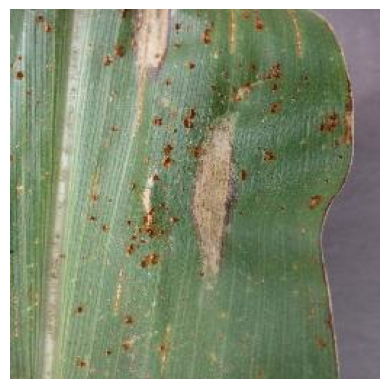

Actual Class: Corn_(maize)___Northern_Leaf_Blight
Predictions of Color Ensembled Model: Corn_(maize)___Northern_Leaf_Blight
Predictions of Grayscale Ensembled Model: Corn_(maize)___Northern_Leaf_Blight
Predictions of Segmented Ensembled Model: Corn_(maize)___Northern_Leaf_Blight
Final Ensembled Prediction: Corn_(maize)___Northern_Leaf_Blight


In [23]:
import matplotlib.pyplot as plt

# Select a single image, its actual class label, and its corresponding predictions of ensembled models
image = batch_images_color[6]
actual_label = batch_labels_color[6]
prediction_color = ensemble_predicted_classes_color[6]
prediction_gray = ensemble_predicted_classes_grayscale[6]
prediction_segmented = ensemble_predicted_classes_segmented[6]
final_prediction = final_predictions[6]

# Display the image
plt.imshow(image)
plt.axis('off')
plt.show()

# Get the actual class label
actual_class = class_names[np.argmax(actual_label)]

# Display the actual class of the image
print("Actual Class:", actual_class)

# Display the predictions of all ensembled models
print("Predictions of Color Ensembled Model:", class_names[prediction_color])
print("Predictions of Grayscale Ensembled Model:", class_names[prediction_gray])
print("Predictions of Segmented Ensembled Model:", class_names[prediction_segmented])

# Display the final ensembled prediction
print("Final Ensembled Prediction:", class_names[final_prediction])
